In [27]:
import pandas as pd
from datetime import datetime
##########################################EXTRACTING BASEFLOW##############################################
# Read the CSV file
data = pd.read_csv('C:/Users/carsk/OneDrive - KU Leuven/Thesis/Revised_RESULTS/Baseflow/For_baseflow_extraction.csv')
data.head()

,date,C02,U05,U09,U19,U17,WOL4,WOL5,WOL7,MAL1,ZEN6,ZEN3,BNV4,BNV8,MOL5,C01,C11,U06,U11
0,01/01/2016 00:00,153.0,614.0,288.1,315.0,148.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,59.0,24.9316,0.0,44.0
1,01/01/2016 00:05,149.0,610.0,288.6,300.0,150.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.0,24.3920,0.0,20.0
2,01/01/2016 00:10,150.0,614.0,288.6,300.0,148.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.0,24.4950,0.0,12.0
3,01/01/2016 00:15,147.0,610.0,289.7,305.0,148.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,59.0,24.3008,0.0,7.0
4,01/01/2016 00:20,145.0,614.0,289.7,290.0,148.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,57.0,24.5068,0.0,6.0


In [28]:
data[['BNV4','U11']].describe()

,BNV4,U11
count,315577.000000,315697.000000
mean,0.017816,44.946214
std,0.289705,61.154590
min,0.000000,-149.000000
25%,0.000000,14.000000
50%,0.000000,24.000000
75%,0.000000,46.000000
max,51.901603,1376.000000


In [29]:
#plot c11 and mal1
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 6))
plt.plot(data['date'], data['U11'], label='U1')
plt.plot(data['date'], data['BNV4'], label='BNV4')
plt.legend()
plt.show()


KeyboardInterrupt: 

Here select the range in data which you like to extract baseflow


C:\Users\carsk\AppData\Local\Temp\ipykernel_25636\2809499015.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Here select the range in data which you like to extract baseflow


C:\Users\carsk\AppData\Local\Temp\ipykernel_25636\2809499015.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Here select the range in data which you like to extract baseflow


C:\Users\carsk\AppData\Local\Temp\ipykernel_25636\2809499015.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Here select the range in data which you like to extract baseflow


C:\Users\carsk\AppData\Local\Temp\ipykernel_25636\2809499015.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Here select the range in data which you like to extract baseflow


C:\Users\carsk\AppData\Local\Temp\ipykernel_25636\2809499015.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



                       U19  Baseflow  U19_without_baseflow  BNV8
date                                                            
2016-01-01 00:00:00  315.0     387.0                   0.0   0.0
2016-01-01 00:05:00  300.0     392.0                   0.0   0.0
2016-01-01 00:10:00  300.0     389.0                   0.0   0.0
2016-01-01 00:15:00  305.0     372.0                   0.0   0.0
2016-01-01 00:20:00  290.0     367.0                   0.0   0.0
...                    ...       ...                   ...   ...
2018-06-30 23:35:00  364.0     487.0                   0.0   0.0
2018-06-30 23:40:00  359.0     504.0                   0.0   0.0
2018-06-30 23:45:00  359.0     501.0                   0.0   0.0
2018-06-30 23:50:00  357.0     482.0                   0.0   0.0
2018-06-30 23:55:00  357.0     460.0                   0.0   0.0

[264136 rows x 4 columns]


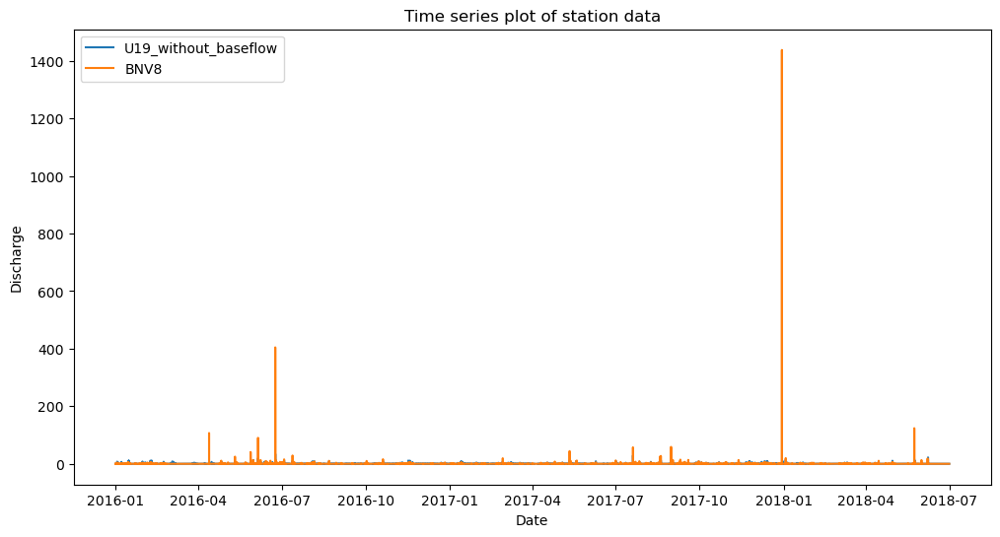

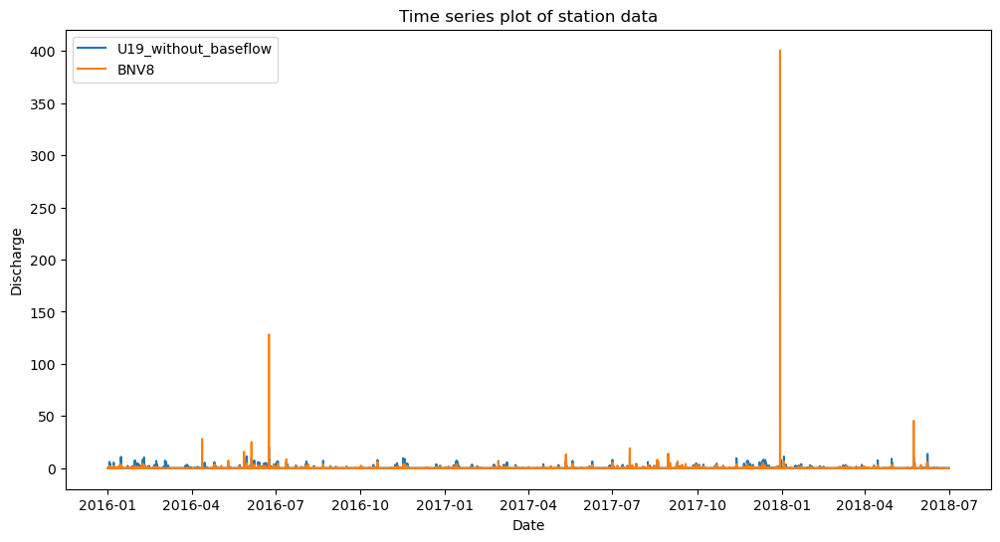

In [33]:
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio

# Function to do the processing
def process_period(data, start_date, end_date, avg_start_date, avg_end_date, station_code, model_station_code):
    # Filter the dataframe by dates
    filtered_data = data[(data['date'] >= start_date) & (data['date'] <= end_date)]
    
    average_data= data[(data['date'] >= avg_start_date) & (data['date'] <= avg_end_date)]
    
    # Extract only the time part of the dates
    average_data['time'] = average_data['date'].dt.time
    
    # Group by time and calculate the average of the station column
    average_df = average_data.groupby('time')[station_code].max().reset_index()
    
    # Rename the station code column to 'Average'
    average_df.rename(columns={station_code: 'Average'}, inplace=True)
    
    # Create a DataFrame with a date range from date1 to date2
    baseflow = pd.DataFrame(index=pd.date_range(start=start_date, end=end_date, freq='5T'))
    baseflow.reset_index(inplace=True)
    baseflow.rename(columns={'index': 'date'}, inplace=True)
    
    # Extract only the time part of the dates
    baseflow['time'] = baseflow['date'].dt.time
    
    # Merge baseflow with average_df, making the values repeat until the date range is complete
    baseflow = pd.merge(baseflow, average_df, how='left', left_on='time', right_on='time')
    
    # Remove the 'time' column
    baseflow.drop(columns='time', inplace=True)
    
    # Make sure the dates are in the index for easy data manipulation in the future
    baseflow.set_index('date', inplace=True)
    
    # Reindex the station data to match baseflow's index
    if 'date' in filtered_data.columns:
        filtered_data.set_index('date', inplace=True)
    
    # Create a new DataFrame with original station data
    station_without_baseflow = filtered_data[[station_code]].copy()
    
    # Subtract the baseflow from the station data and add it as a new column
    station_without_baseflow[f"{station_code}_without_baseflow"] = (((station_without_baseflow[station_code] - baseflow['Average']))/1000).clip(lower=0)
    
    # Insert the 'Average' column from baseflow in the middle of the 'station_without_baseflow' DataFrame
    station_without_baseflow.insert(1, 'Baseflow', baseflow['Average'])
    
    # Extract the modeled station data
    model_station_data = filtered_data[[model_station_code]].copy()
    model_station_data[model_station_code] = model_station_data[model_station_code] 
    
    # Merge the modeled station data with the 'station_without_baseflow' DataFrame
    station_without_baseflow = pd.merge(station_without_baseflow, model_station_data, how='left', left_index=True, right_index=True)

    return station_without_baseflow

# Read the CSV file

# Read the CSV file
data = pd.read_csv('C:/Users/carsk/OneDrive - KU Leuven/Thesis/Revised_RESULTS/Baseflow/For_baseflow_extraction.csv')

# Convert the 'date' column to datetime
data['date'] = pd.to_datetime(data['date'], format='%d/%m/%Y %H:%M')

# Ask the user for the station code
station_code = input('Please enter the station code: ').upper()

# Ask the user for the second station code
model_station_code = input('Please enter the modeled station code: ').upper()

# Check if the station code is valid
if station_code not in data.columns or model_station_code not in data.columns:
    print('The provided station code is not valid.')
else:
    final_df = pd.DataFrame()

    while True:
        try:
            # Ask the user for the dates
            print("Here select the range in data which you like to extract baseflow")
            date_str1 = input('Please enter the start date (DD-MM-YYYY HH:MM): ')
            date_str2 = input('Please enter the end date (DD-MM-YYYY HH:MM): ')
    
            # Convert the dates to datetime
            date1 = datetime.strptime(date_str1, '%d-%m-%Y %H:%M')
            date2 = datetime.strptime(date_str2, '%d-%m-%Y %H:%M')
            
            # Ask the user for the dates to calculate the average 5-minute discharge
            avg_date_str1 = input('Initial date for average calculation (DD-MM-YYYY HH:MM): ')
            avg_date_str2 = input('Final date for average calculation (DD-MM-YYYY HH:MM): ')
            
            # Convert the dates to datetime
            avg_date1 = datetime.strptime(avg_date_str1, '%d-%m-%Y %H:%M')
            avg_date2 = datetime.strptime(avg_date_str2, '%d-%m-%Y %H:%M')
        except ValueError:
            print('The provided date format is not valid.')
        
        # Process the period
        period_df = process_period(data, date1, date2, avg_date1, avg_date2, station_code, model_station_code)
        
        # Append to final dataframe
        final_df = pd.concat([final_df, period_df])
        
        # Ask the user if they want to add another period
        cont = input('Do you want to add another period? (Y/N) ')
        
        if cont.lower() != 'y':
            break

    print(final_df)

    # Plotting the data using matplotlib
    plt.figure(figsize=(12, 6))
    plt.plot(final_df.index, final_df[f"{station_code}_without_baseflow"], label=f"{station_code}_without_baseflow")
    plt.plot(final_df.index, final_df[model_station_code], label=model_station_code)
    plt.legend()
    plt.title('Time series plot of station data')
    plt.xlabel('Date')
    plt.ylabel('Discharge')
    plt.show()

    # Plotting the data using plotly
    fig = px.line(final_df.reset_index(), x='date', y=[f"{station_code}_without_baseflow", model_station_code])
    fig.show()

    # Save the plot as an HTML file
    pio.write_html(fig, 'output.html')

    # Save the final DataFrame as a CSV file
    final_df.to_csv('output.csv')


final_df_resampled = final_df.resample('1H').mean()
final_df_resampled.to_csv('1H_resampl.csv')

 # Plotting the data using matplotlib
plt.figure(figsize=(12, 6))
plt.plot(final_df_resampled.index, final_df_resampled[f"{station_code}_without_baseflow"], label=f"{station_code}_without_baseflow")
plt.plot(final_df_resampled.index, final_df_resampled[model_station_code], label=model_station_code)
plt.legend()
plt.title('Time series plot of station data')
plt.xlabel('Date')
plt.ylabel('Discharge')
plt.show()
 # Plotting the data using plotly
fig = px.line(final_df_resampled.reset_index(), x='date', y=[f"{station_code}_without_baseflow", model_station_code])
fig.show()

# Save the plot as an HTML file
pio.write_html(fig, 'resampled.html')


In [24]:
final_df_resampled.to_csv('C:/Users/carsk/OneDrive - KU Leuven/Thesis/Revised_RESULTS/Routing_Runoff/MAL1/1H_resampl.csv')

In [ ]:
final_df.to_csv('C:/Users/carsk/OneDrive - KU Leuven/Thesis/Revised_RESULTS/Routing_Runoff/MAL1/5mins.csv')